In [26]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [108]:
from os.path import join
from glob import glob
from combine_nets.get_insta_images import download_images
from combine_nets.build_embedings import ImagePredictor
from pathlib import Path
from PIL import Image, UnidentifiedImageError
from tqdm import tqdm
import torch
import matplotlib.pyplot as plt
import pickle
from matplotlib import gridspec


In [66]:
root_dir = Path('../restaurant_dataset/')

In [67]:
restaurants = glob(join(root_dir, '*'))

In [17]:
insta_images = download_images()

Using cache found in /Users/yury/.cache/torch/hub/pytorch_vision_master


https://instagram.fhrk1-1.fna.fbcdn.net/v/t51.2885-15/e35/c0.180.1440.1440a/s150x150/126336206_865236640682978_2344174815437822524_n.jpg?_nc_ht=instagram.fhrk1-1.fna.fbcdn.net&_nc_cat=1&_nc_ohc=mN7Mo44F0coAX-9mGE7&tp=1&oh=0bd85eab4d3f02c10d259ee93754758e&oe=5FE35293
https://instagram.fhrk1-1.fna.fbcdn.net/v/t51.2885-15/e35/s150x150/123228945_3329629723802191_5889572144787479607_n.jpg?_nc_ht=instagram.fhrk1-1.fna.fbcdn.net&_nc_cat=107&_nc_ohc=XDrzhQWjNS4AX-QJoIk&tp=1&oh=2e41d02a6f6a2e5afebe2e32b28aed5d&oe=5FBD1A4E
https://instagram.fhrk1-1.fna.fbcdn.net/v/t51.2885-15/e35/c0.180.1440.1440a/s150x150/122828130_1004110713391430_4407864791860020883_n.jpg?_nc_ht=instagram.fhrk1-1.fna.fbcdn.net&_nc_cat=102&_nc_ohc=DDVY1QuNbQwAX-d38oX&tp=1&oh=cb53a26625707ba0ae2a0a36e89424f1&oe=5FE27FE0
https://instagram.fhrk1-1.fna.fbcdn.net/v/t51.2885-15/e35/p150x150/122724098_682436929051109_9081446399525587438_n.jpg?_nc_ht=instagram.fhrk1-1.fna.fbcdn.net&_nc_cat=105&_nc_ohc=3dOtRO-Y2MIAX_jXkXw&tp=1&oh=99911

In [44]:

image_predictor = ImagePredictor()

In [45]:
insta_embeddings = [image_predictor.predict_image(img)[0] for img in insta_images]

In [73]:
restaurant_to_embedding = {}
bad_imgs = []
for restaurant in tqdm(restaurants):
    restaurant_to_embedding[restaurant] = []
    for category in glob(join(restaurant, '*')):
        for food in glob(join(category, '*')):
            try:
                img = Image.open(food)
                food_data = {
                    'path': food,
                    'emnb': image_predictor.predict_image(img)[0]
                }
                restaurant_to_embedding[restaurant].append(food_data)

            except UnidentifiedImageError:
                bad_imgs.append(food)

100%|██████████| 50/50 [09:55<00:00, 11.91s/it]


In [78]:
# pickle.dump(restaurant_to_embedding, open('emb_backup.pck', 'wb'))

In [87]:
top_emb = []

for insta_dish in tqdm(insta_embeddings):
    min_dist = float('inf')
    top_emb.append(dict())
    for restaurant in restaurant_to_embedding:
        cur_min_dist = min_dist
        scores = []
        paths = []
        for dish in restaurant_to_embedding[restaurant]:
            path = dish['path']
            emb = dish['emnb']

            dist = torch.dist(insta_dish, emb)
            cur_min_dist = min(min_dist, dist.item())
            scores.append(dist)
            paths.append(path)

        if cur_min_dist < min_dist:
            scores = torch.tensor(scores)
            indexes = torch.argsort(scores)
            top_emb[-1] = {
                'name': restaurant,
                'scores': scores[indexes[:5]],
                'path': [paths[i] for i in indexes[:5]]
            }

            min_dist = cur_min_dist
    print(min_dist)

100%|██████████| 10/10 [00:00<00:00, 20.82it/s]


10.108709335327148
10.123929023742676
11.245550155639648
9.161287307739258
12.190450668334961
10.226579666137695
12.139955520629883
10.161919593811035
11.378898620605469
10.55334186553955


In [151]:
def show_by_index(index):
    image = insta_images[index]
    paths = top_emb[index]['path']
    scores = top_emb[index]['scores']
    name = top_emb[index]['name']
    top_image = Image.open(paths[0])

    rest_image = [Image.open(img_pth) for img_pth in paths[1:]]

    fig = plt.figure(dpi=300, tight_layout=True)
    fig.set_size_inches(10, 5, forward=True)

    gs = gridspec.GridSpec(2, 4)
    ax = fig.add_subplot(gs[:, 0])
    ax.imshow(image, aspect="auto")
    ax.axis('off')
    ax.set_title('Original')

    ax = fig.add_subplot(gs[:, 1])
    ax.imshow(top_image, aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[0].item()}')

    ax = fig.add_subplot(gs[0, 2])
    ax.imshow(rest_image[0], aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[1].item()}')

    ax = fig.add_subplot(gs[1, 2])
    ax.imshow(rest_image[1], aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[2].item()}')

    ax = fig.add_subplot(gs[0, 3])
    ax.imshow(rest_image[2], aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[3].item()}')

    ax = fig.add_subplot(gs[1, 3])
    ax.imshow(rest_image[3], aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[4].item()}')

    plt.show()

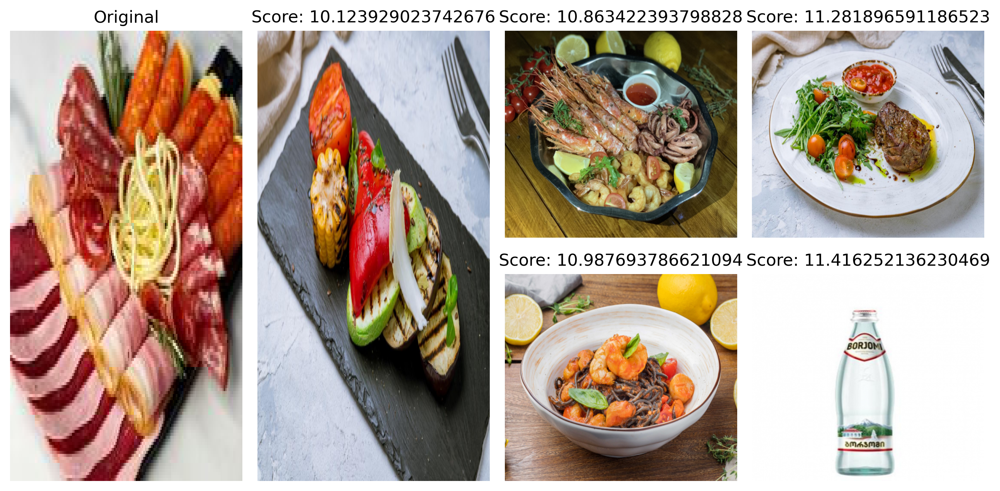

In [161]:
show_by_index(1)

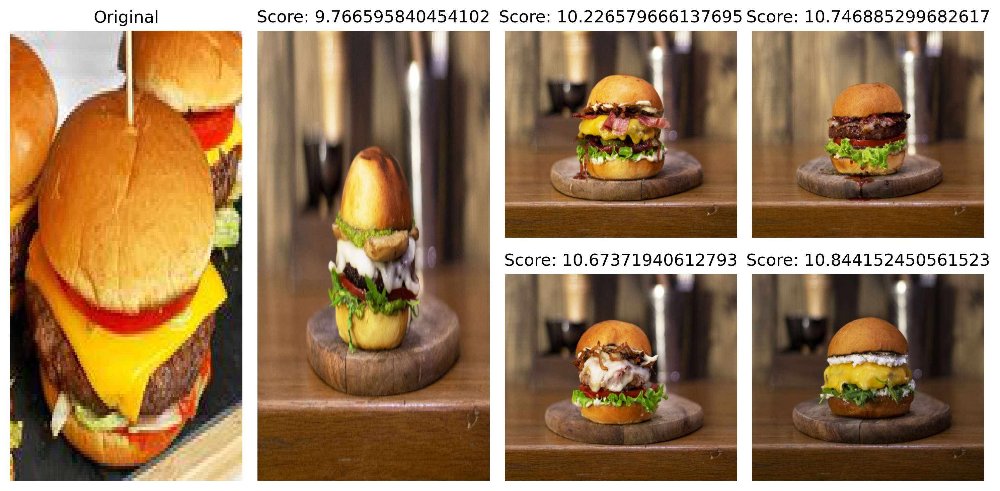

In [156]:
show_by_index(5)

In [ ]:
show_by_index(6)

In [ ]:
show_by_index(7)

In [ ]:
show_by_index(8)

In [ ]:
show_by_index(9)

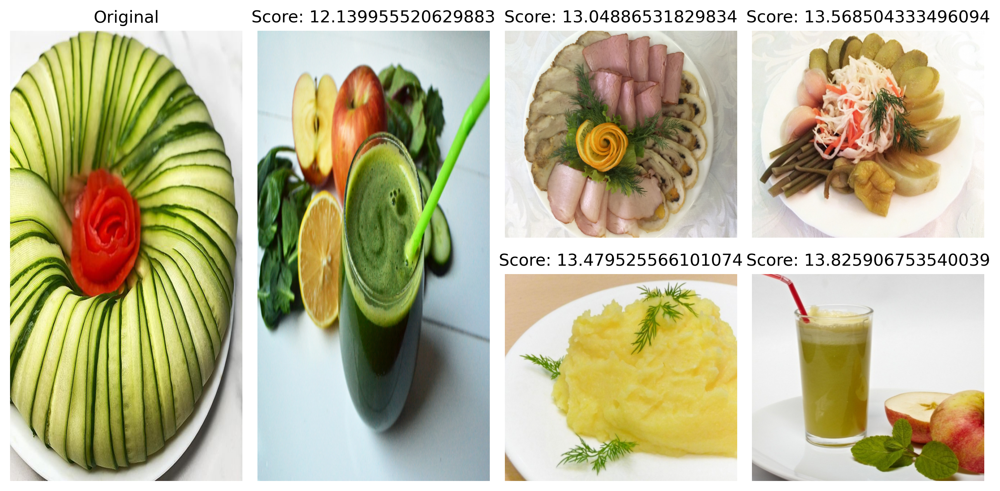

In [157]:
show_by_index(9)

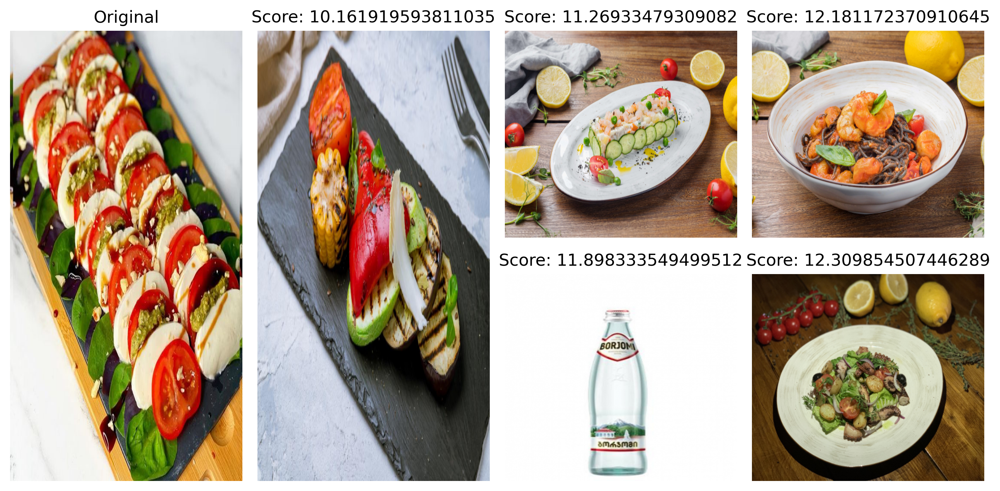

In [158]:
show_by_index(7)

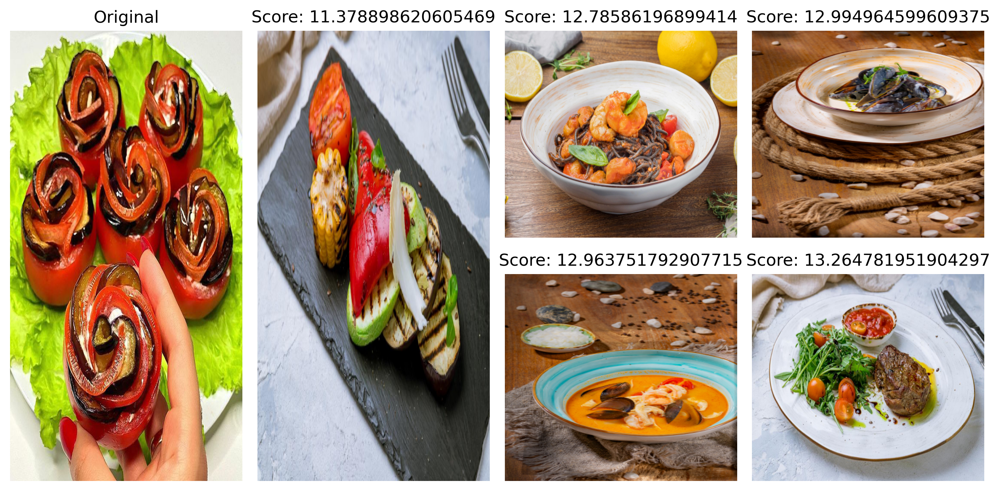

In [159]:
show_by_index(8)

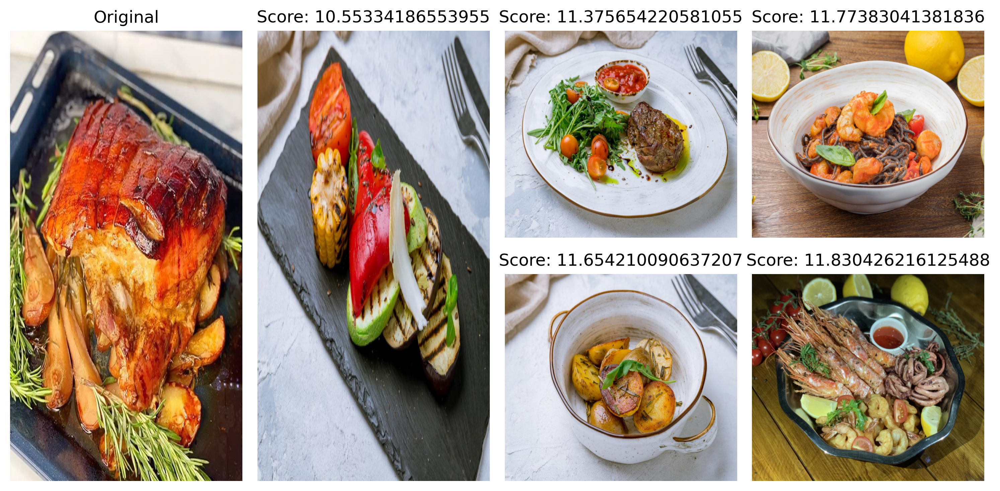

In [160]:
show_by_index(9)